In [1]:
# !pip install lpips
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os
from PIL import Image

import torch
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torch.optim import AdamW

from diffusers import AutoencoderKL, UNet2DConditionModel, UNet2DModel

from datetime import datetime

import lpips
from skimage.metrics import structural_similarity
from skimage.color import rgb2lab, deltaE_ciede2000

# Carpeta donde guardar
SAVE_DIR = "checkpoints"
os.makedirs(SAVE_DIR, exist_ok=True)

def save_model(unet, opt, loss):
    # Fecha y hora actual
    timestamp = datetime.now().strftime("%m%d_%H%M")
    filename = f"unet_base_{timestamp}.pt"
    path = os.path.join(SAVE_DIR, filename)

    # Guardar estado del modelo y optimizador
    torch.save({
        "model_state_dict": unet.state_dict(),
        "optimizer_state_dict": opt.state_dict(),
        "loss": loss,
    }, path)
    print(f"Modelo guardado en {path}")

2025-12-13 14:03:24.044716: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1765634604.067219     232 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1765634604.073734     232 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

AttributeError: 'MessageFactory' object has no attribute 'GetPrototype'

## Train

### Load data

In [2]:
# -----------------------------
# Dataset: devuelve pares RGB / Gray
# -----------------------------
class ColorizationDataset(Dataset):
    def __init__(self, img_dir, size=128):
        self.img_dir = img_dir
        self.files = [f for f in os.listdir(img_dir) if f.endswith((".jpg",".png"))]
        self.size = size
        self.to_tensor = transforms.Compose([
            transforms.Resize((size, size)),
            transforms.ToTensor(),
            transforms.Normalize([0.5], [0.5])  # [-1,1]
        ])

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        path = os.path.join(self.img_dir, self.files[idx])
        img_rgb = Image.open(path).convert("RGB")
        img_gray = img_rgb.convert("L").convert("RGB")  # 3 canales para VAE

        rgb_tensor = self.to_tensor(img_rgb)   # [3,H,W]
        gray_tensor = self.to_tensor(img_gray) # [3,H,W]

        return {"rgb": rgb_tensor, "gray": gray_tensor}

class LatentDataset(Dataset):
    def __init__(self, latent_file):
        data = torch.load(latent_file)
        self.rgb = data["rgb"]
        self.gray = data["gray"]

    def __len__(self):
        return self.rgb.size(0)

    def __getitem__(self, idx):
        return {"rgb": self.rgb[idx], "gray": self.gray[idx]}


In [3]:
# Dataset original con imágenes
# Limitar a un máximo de imágenes
def generar_latente(max_images = 100, path = None):
    dataset = ColorizationDataset("/kaggle/input/unlabeled_images", size=128)
    if len(dataset) > max_images:
        dataset.files = dataset.files[:max_images]
    
    loader = DataLoader(dataset, batch_size=16, shuffle=False)
    
    
    vae = AutoencoderKL.from_pretrained(
        "runwayml/stable-diffusion-v1-5",
        subfolder="vae"
    ).to("cuda")
    vae.requires_grad_(False)
    
    latents_rgb, latents_gray = [], []
    
    with torch.no_grad():
        for batch in loader:
            rgb = batch["rgb"].to("cuda")
            gray = batch["gray"].to("cuda")
    
            z_rgb = vae.encode(rgb).latent_dist.sample() * 0.18215
            z_gray = vae.encode(gray).latent_dist.sample() * 0.18215
    
            latents_rgb.append(z_rgb.cpu())
            latents_gray.append(z_gray.cpu())
    
    latents_rgb = torch.cat(latents_rgb)
    latents_gray = torch.cat(latents_gray)
    if not path:
        path = f"stl10_latents_{max_images}.pt"
    torch.save({"rgb": latents_rgb, "gray": latents_gray}, path)
generar_latente(25000)

### Cargar modelos e hiperparámetros

In [7]:
# -----------------------------
# Hiperparámetros
# -----------------------------
NUM_EPOCHS = 250
EPOCHS_VISUALIZATION = 25
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
BATCH_SIZE = 512
LR = 1e-3
SIZE = 128

# -----------------------------
# Modelos: VAE congelado y UNet entrenable
# -----------------------------
device = DEVICE

vae = AutoencoderKL.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    subfolder="vae"
).to(DEVICE)
vae.requires_grad_(False)

unet = UNet2DModel(
    sample_size=SIZE // 8,
    in_channels=4,
    out_channels=4,
    layers_per_block=2,
    block_out_channels=(128, 256, 256),
    down_block_types=("DownBlock2D", "DownBlock2D", "AttnDownBlock2D"),
    up_block_types=("AttnUpBlock2D", "UpBlock2D", "UpBlock2D")
).to(DEVICE)

# -----------------------------
# Dataloader
# -----------------------------
dataset = LatentDataset("stl10_latents_25000.pt")

# Dataset de validación (aún con imágenes, para visualizar resultados)
val_dataset = ColorizationDataset("/kaggle/input/train_images", size=SIZE)

loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4)

# -----------------------------
# Optimizador
# -----------------------------
opt = AdamW(unet.parameters(), lr=LR, weight_decay=0.01)

### Bucle entrenamiento

In [8]:
def visualize_validation(vae, unet, val_dataset, device=DEVICE, step_list=[15,30,50], num_samples=2, color_scale=1.0):
    indices = np.random.choice(len(val_dataset), num_samples, replace=False)
    fig, axes = plt.subplots(num_samples, len(step_list)+2, figsize=(15, 5*num_samples), squeeze=False)

    for i, idx in enumerate(indices):
        sample = val_dataset[idx]
        gray = sample["gray"].unsqueeze(0).to(device)
        rgb_img = (sample["rgb"].detach().cpu().permute(1,2,0).numpy()*0.5+0.5).clip(0,1)
        gray_img = (sample["gray"].detach().cpu().permute(1,2,0).numpy()*0.5+0.5).clip(0,1)

        axes[i,0].imshow(gray_img)
        axes[i,0].set_title("Grayscale input")
        axes[i,0].axis("off")

        with torch.no_grad():
            z_gray = vae.encode(gray).latent_dist.sample() * 0.18215

            for j, steps in enumerate(step_list):
                z_t = z_gray.clone()
                ts = torch.linspace(1.0, 0.0, steps, device=device)
                for t in ts:
                    t_int = torch.tensor([int(t.item()*999)], device=device)
                    delta_t = unet(sample=z_t, timestep=t_int).sample
                    z_t = z_t + (1.0/steps) * delta_t

                z_col = z_gray + color_scale * (z_t - z_gray)
                out_rgb = vae.decode(z_col / 0.18215).sample.squeeze(0)
                out_img = (out_rgb.detach().cpu().permute(1,2,0).numpy()*0.5+0.5).clip(0,1)

                axes[i,j+1].imshow(out_img)
                axes[i,j+1].set_title(f"Colorized ({steps} steps)")
                axes[i,j+1].axis("off")

        axes[i,len(step_list)+1].imshow(rgb_img)
        axes[i,len(step_list)+1].set_title("Original RGB")
        axes[i,len(step_list)+1].axis("off")

    plt.tight_layout()
    plt.show()


Epoch 25/250 - Loss: 0.0425
color_scale=1.2


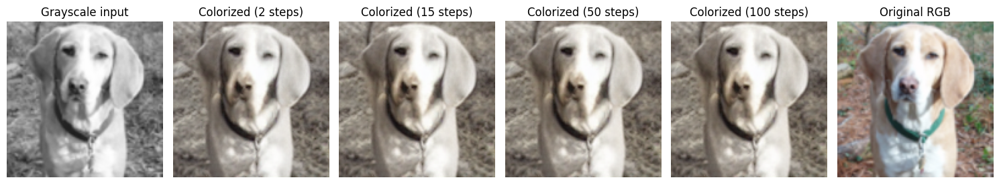

color_scale=1.4


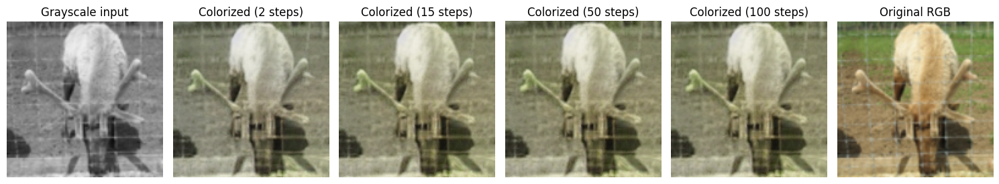

color_scale=1.6


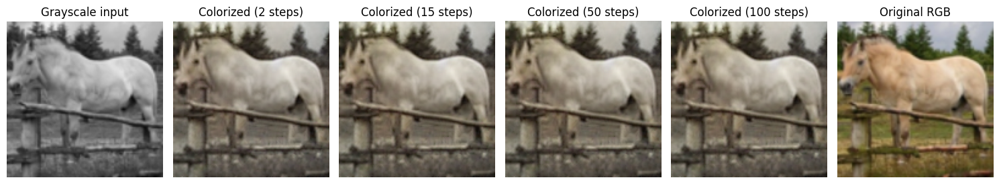

color_scale=1.8


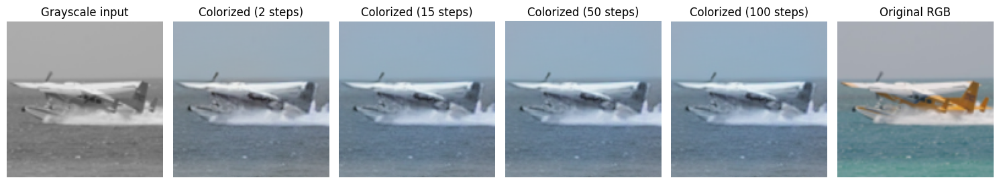

Epoch 50/250 - Loss: 0.0377
color_scale=1.2


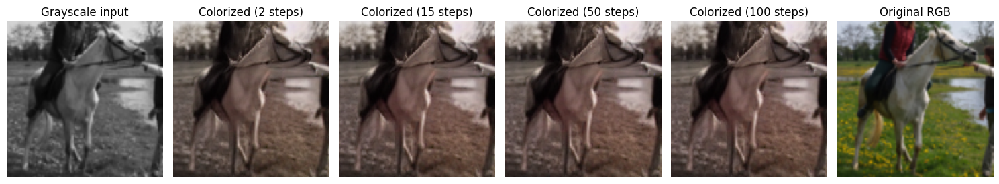

color_scale=1.4


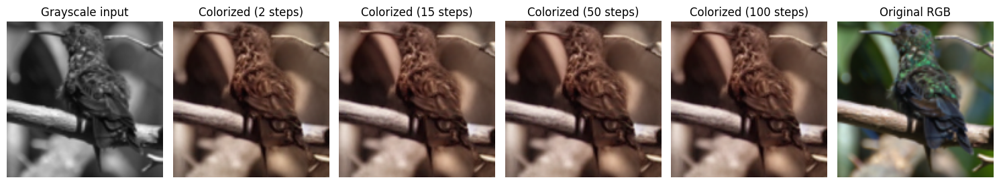

color_scale=1.6


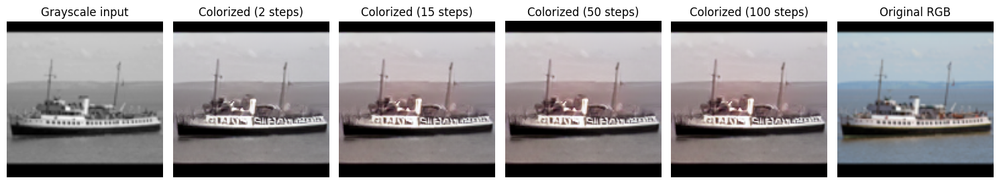

color_scale=1.8


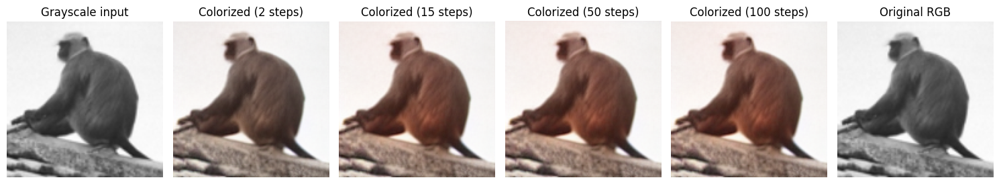

Epoch 75/250 - Loss: 0.0346
color_scale=1.2


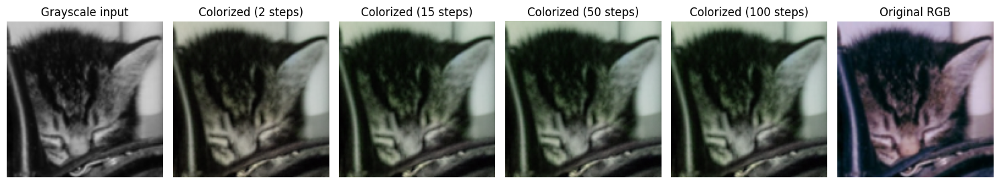

color_scale=1.4


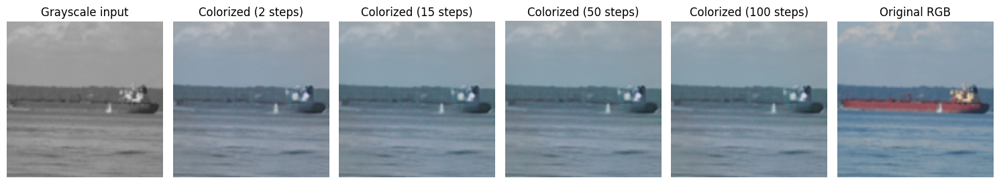

color_scale=1.6


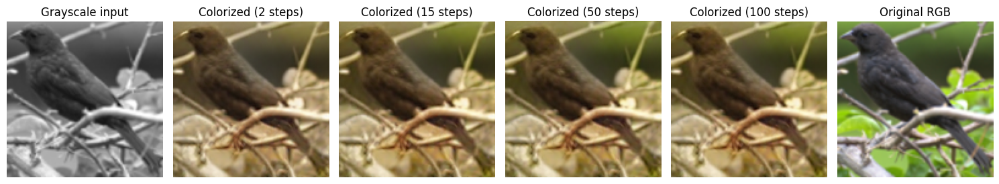

color_scale=1.8


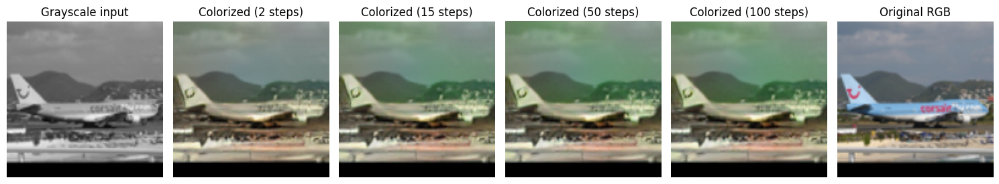

Epoch 100/250 - Loss: 0.0352
color_scale=1.2


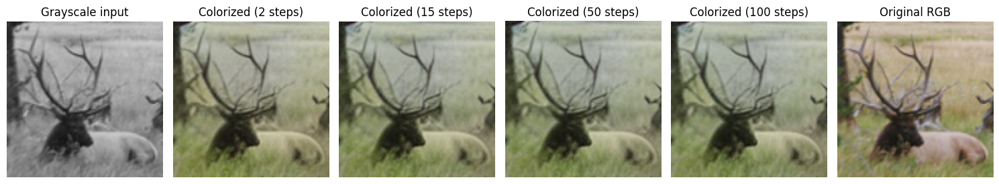

color_scale=1.4


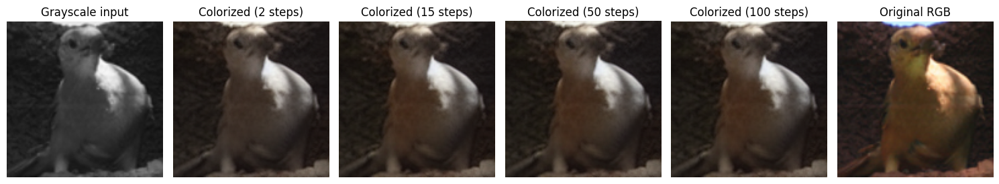

color_scale=1.6


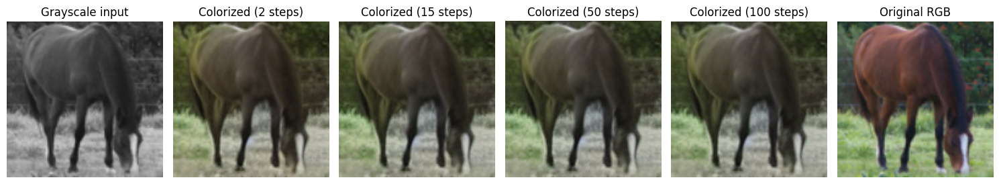

color_scale=1.8


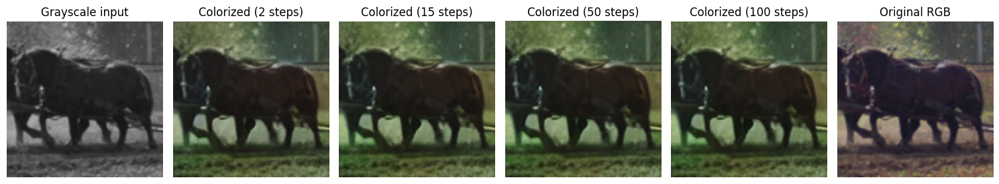

Epoch 125/250 - Loss: 0.0321
color_scale=1.2


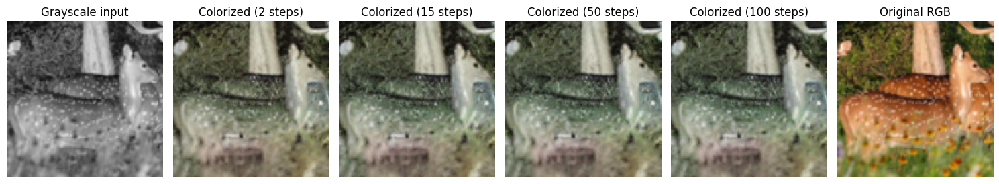

color_scale=1.4


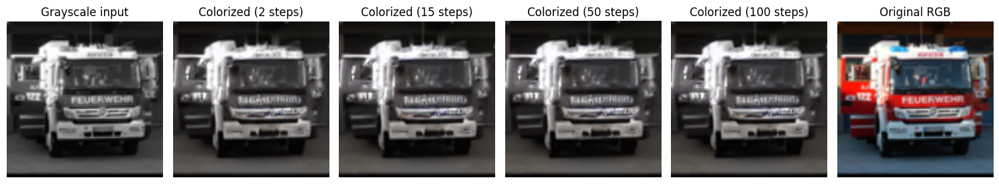

color_scale=1.6


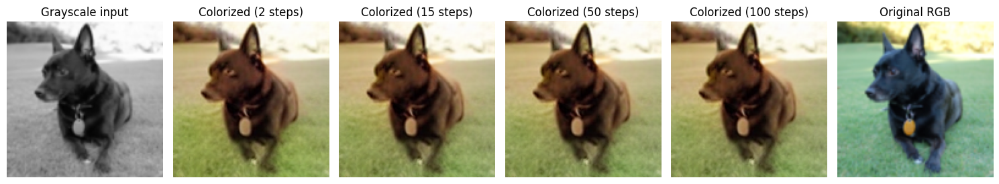

color_scale=1.8


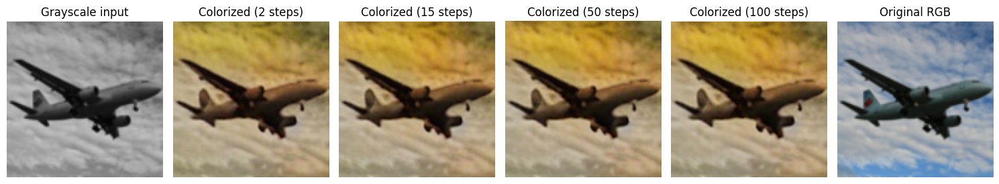

Epoch 150/250 - Loss: 0.0284
color_scale=1.2


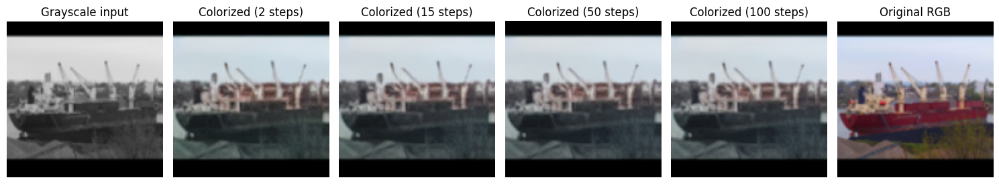

color_scale=1.4


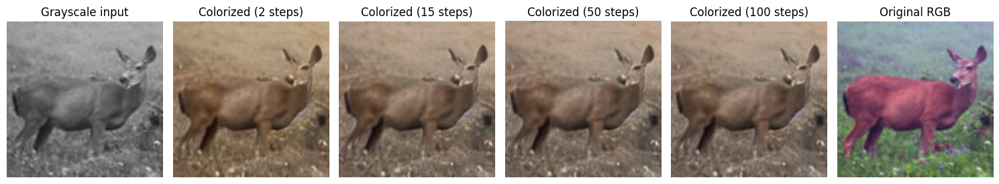

color_scale=1.6


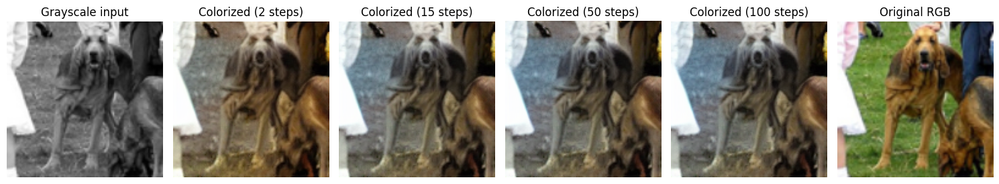

color_scale=1.8


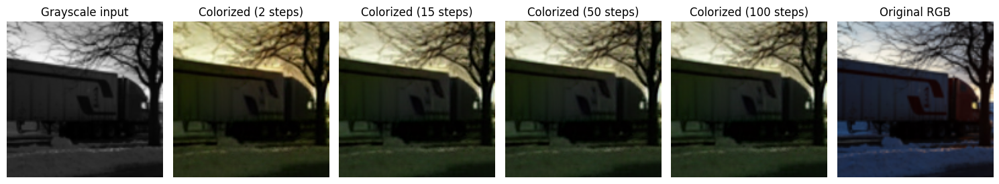

Epoch 175/250 - Loss: 0.0294
color_scale=1.2


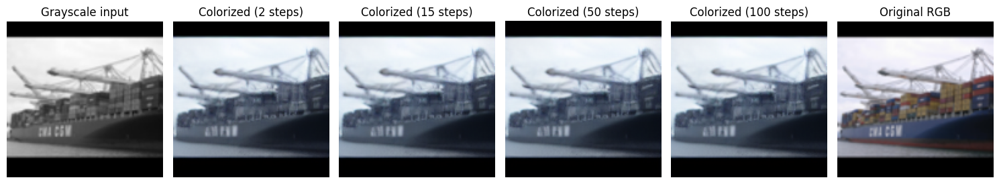

color_scale=1.4


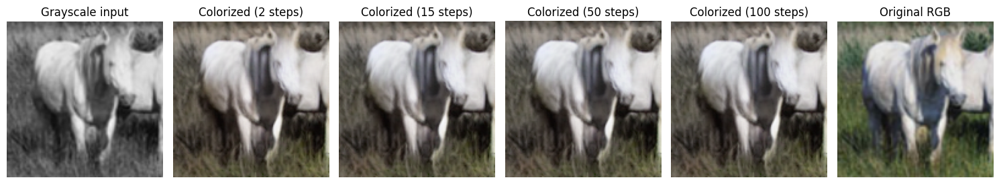

color_scale=1.6


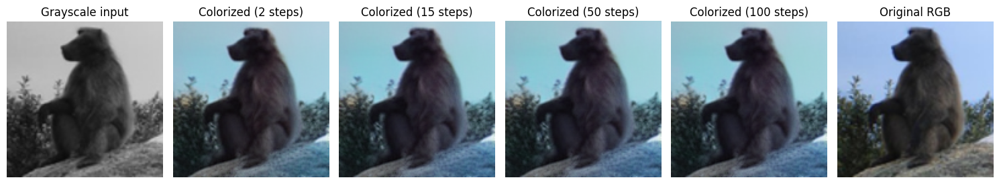

color_scale=1.8


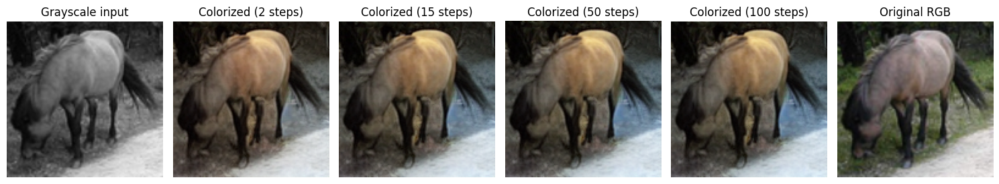

Epoch 200/250 - Loss: 0.0307
color_scale=1.2


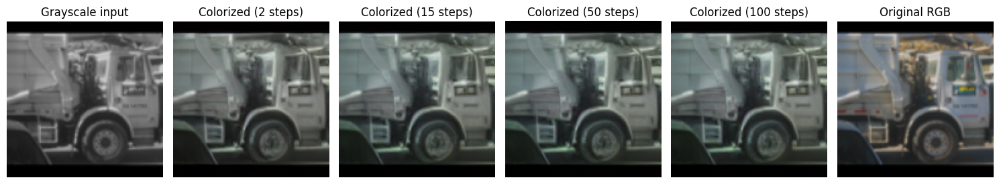

color_scale=1.4


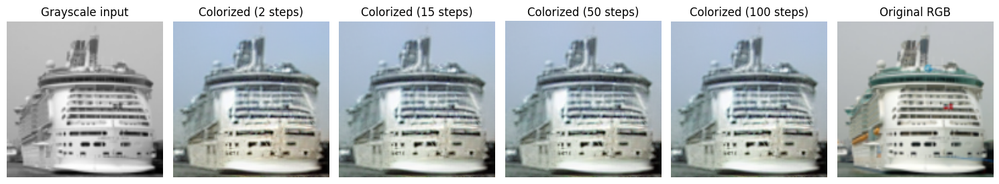

color_scale=1.6


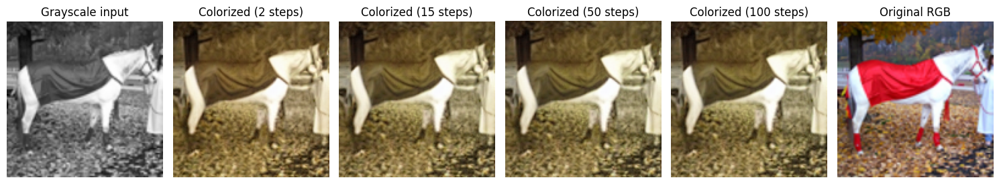

color_scale=1.8


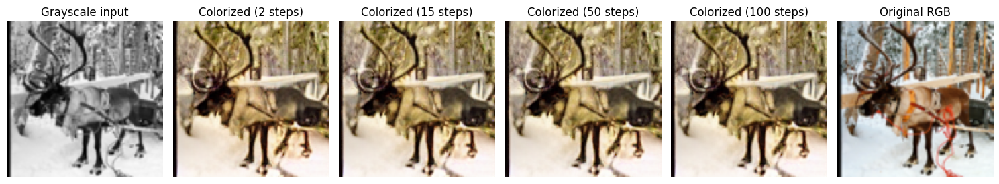

Epoch 225/250 - Loss: 0.0267
color_scale=1.2


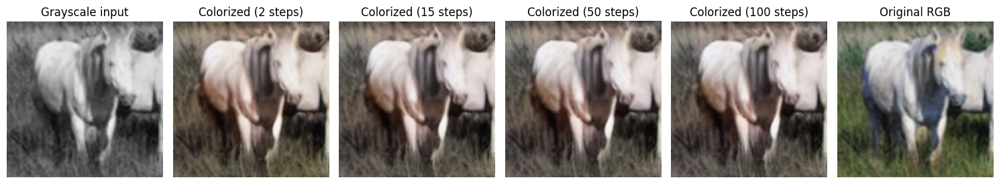

color_scale=1.4


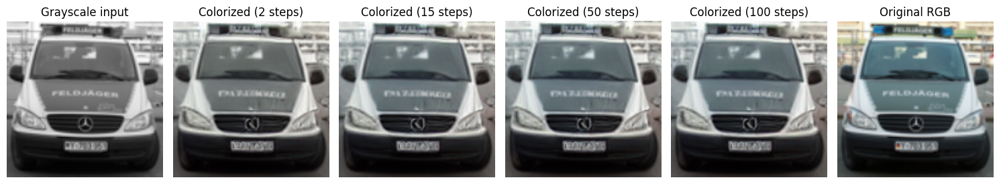

color_scale=1.6


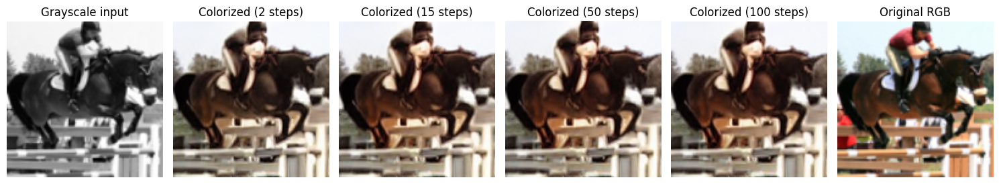

color_scale=1.8


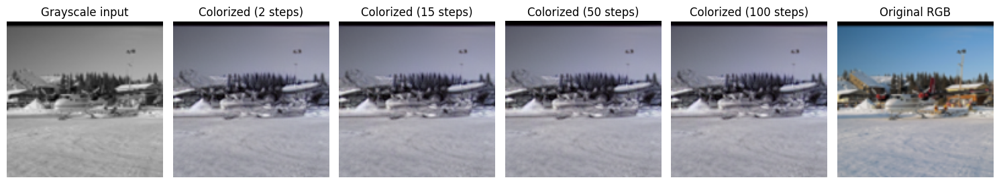

Epoch 250/250 - Loss: 0.0257
color_scale=1.2


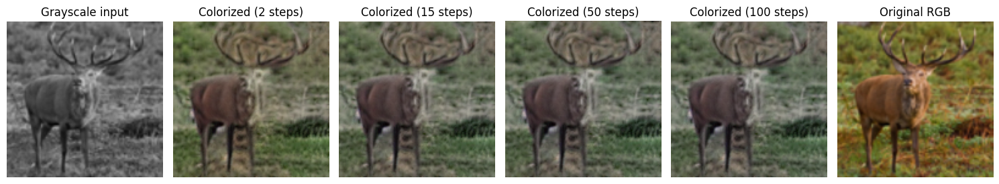

color_scale=1.4


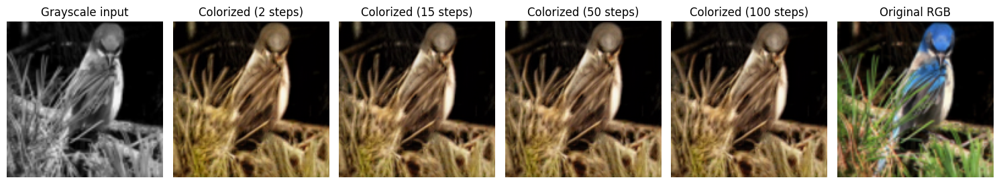

color_scale=1.6


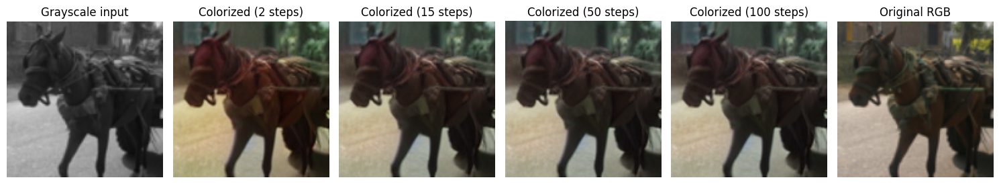

color_scale=1.8


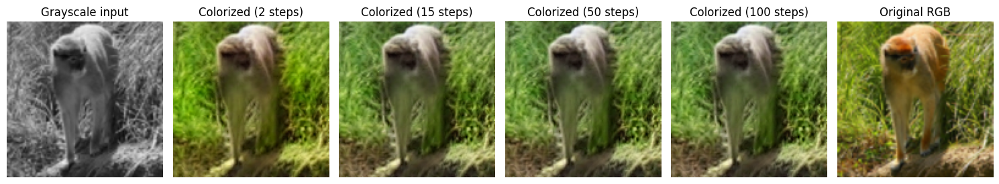

In [9]:
for epoch in range(NUM_EPOCHS):
    for batch in loader:
        z_rgb = batch["rgb"].to(DEVICE)   # latente RGB
        z_gray = batch["gray"].to(DEVICE) # latente gris

        # Mezcla temporal
        t = torch.rand(z_rgb.size(0), device=DEVICE)
        z_t = (1 - t.view(-1,1,1,1)) * z_gray + t.view(-1,1,1,1) * z_rgb
        target = z_rgb

        # Diffusers espera timesteps enteros (0-999)
        t_int = torch.randint(0, 1000, (z_rgb.size(0),), device=DEVICE)

        # Predicción del residuo
        delta_hat = unet(
            sample=z_t,
            timestep=t_int
        ).sample

        # Reconstrucción y loss
        recon = z_t + delta_hat
        loss = F.mse_loss(recon, target)

        opt.zero_grad()
        loss.backward()
        opt.step()
    if (epoch + 1) % (EPOCHS_VISUALIZATION/2) == 0:
        print(f"Epoch {epoch+1}/{NUM_EPOCHS} - Loss: {loss.item():.4f}")

    if (epoch + 1) % EPOCHS_VISUALIZATION == 0:
        print("color_scale=1.2")
        visualize_validation(vae, unet, val_dataset, device=DEVICE, step_list=[2,15,50,100], num_samples=1, color_scale=1.2)
        print("color_scale=1.4")
        visualize_validation(vae, unet, val_dataset, device=DEVICE, step_list=[2,15,50,100], num_samples=1, color_scale=1.4)
        print("color_scale=1.6")
        visualize_validation(vae, unet, val_dataset, device=DEVICE, step_list=[2,15,50,100], num_samples=1, color_scale=1.6)
        print("color_scale=1.8")
        visualize_validation(vae, unet, val_dataset, device=DEVICE, step_list=[2,15,50,100], num_samples=1, color_scale=1.8)

### Guardar

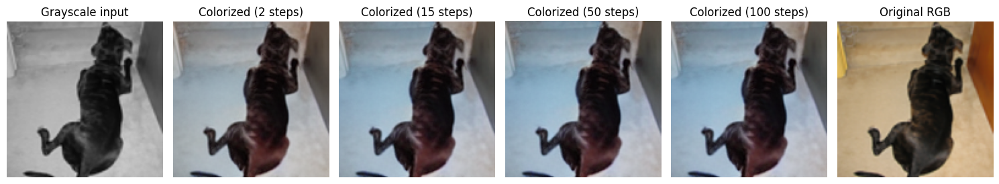

Modelo guardado en checkpoints/unet_base_1213_1622.pt


In [10]:
visualize_validation(vae, unet, val_dataset, device=DEVICE, step_list=[2,15,50,100], num_samples=1, color_scale=1.5)
save_model(unet, opt, loss)

## Inferencia

In [11]:
class Colorizer:
    def __init__(self, vae: AutoencoderKL, unet: UNet2DModel, device='cuda'):
        self.vae = vae.eval().to(device)
        self.unet = unet.eval().to(device)
        self.device = device

    def _preprocess_gray(self, img_gray_pil, size=512):
        img = img_gray_pil.resize((size, size), Image.BICUBIC)
        arr = np.array(img.convert("L").convert("RGB")).astype(np.float32) / 255.0
        arr = (arr - 0.5) / 0.5
        return torch.from_numpy(arr).permute(2,0,1).unsqueeze(0).to(self.device)  # [1,3,H,W]

    def _replace_luma(self, out_rgb_norm, in_gray_norm):
        out = out_rgb_norm.permute(1,2,0).cpu().numpy()*0.5+0.5
        gray = in_gray_norm[0].cpu().numpy()*0.5+0.5
        out_bgr = cv2.cvtColor((out*255).astype(np.uint8), cv2.COLOR_RGB2BGR)
        lab = cv2.cvtColor(out_bgr, cv2.COLOR_BGR2Lab)
        lab[:,:,0] = (gray*255).astype(np.uint8)
        bgr = cv2.cvtColor(lab, cv2.COLOR_Lab2BGR)
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
        return Image.fromarray(rgb)

    @torch.no_grad()
    def colorize(self, gray_img_pil: Image.Image, steps=50, size=512, color_scale=1.0):
        # 1) Preprocesar y codificar
        gray = self._preprocess_gray(gray_img_pil, size)  # [1,3,H,W]
        z_gray = self.vae.encode(gray).latent_dist.sample() * 0.18215
        z_t = z_gray.clone()

        # 2) Iteración de refinamiento
        ts = torch.linspace(1.0, 0.0, steps, device=self.device)
        for t in ts:
            t_int = torch.tensor([int(t.item()*999)], device=self.device)
            # text_emb = torch.zeros((1,77,768), device=self.device)  # dummy text conditioning
            delta_t = self.unet(sample=z_t, timestep=t_int).sample
            z_t = z_t + (1.0/steps) * delta_t

        # 3) Escalado y decodificación
        z_col = z_gray + color_scale * (z_t - z_gray)
        out_rgb = self.vae.decode(z_col / 0.18215).sample.squeeze(0)

        # 4) Reemplazo de luminancia
        final_img = self._replace_luma(out_rgb, gray.squeeze(0))
        return final_img


In [12]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# --- Cargar VAE y UNet entrenado ---
vae = AutoencoderKL.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    subfolder="vae"
).to(DEVICE)
vae.requires_grad_(False)

unet = UNet2DModel(
    sample_size=16,  
    in_channels=4,
    out_channels=4,
    layers_per_block=2,
    block_out_channels=(128, 256, 256),
    down_block_types=("DownBlock2D", "DownBlock2D", "AttnDownBlock2D"),
    up_block_types=("AttnUpBlock2D", "UpBlock2D", "UpBlock2D")
).to(DEVICE)

checkpoint = torch.load("checkpoints/unet_base_1213_1622.pt", map_location=DEVICE)
unet.load_state_dict(checkpoint["model_state_dict"])
unet.eval()

colorizer = Colorizer(vae, unet, device=DEVICE)

# --- Transformaciones ---
transform = transforms.Compose([
    transforms.Resize((128,128)),
    transforms.ToTensor()
])

# --- Métricas ---
lpips_fn = lpips.LPIPS(net='alex').to(DEVICE)

def evaluate_folder(folder_path, num_samples=100):
    mse_scores, ssim_scores, lpips_scores, ciede_scores = [], [], [], []
    files = os.listdir(folder_path)[:num_samples]

    for fname in files:
        img = Image.open(os.path.join(folder_path, fname)).convert("RGB")
        gray = img.convert("L")

        # Colorizar (usa UNet en GPU y VAE en CPU)
        colorized = colorizer.colorize(gray, steps=10, size=256, color_scale=1.5)

        # Tensores para LPIPS (en GPU)
        img_t = transform(img).unsqueeze(0).to(DEVICE)
        col_t = transform(colorized).unsqueeze(0).to(DEVICE)

        with torch.no_grad():
            lp = lpips_fn(img_t, col_t).item()
        lpips_scores.append(lp)

        # Convertir a numpy para métricas en CPU
        img_np = np.array(img.resize((256,256))).astype(np.float32)
        col_np = np.array(colorized.resize((256,256))).astype(np.float32)

        # --- MSE ---
        mse = np.mean((img_np - col_np) ** 2)
        mse_scores.append(mse)

        # --- SSIM ---
        ssim_scores.append(structural_similarity(img_np, col_np, channel_axis=2, data_range=255))

        # --- CIEDE2000 ---
        img_lab = rgb2lab(img_np / 255.0)
        col_lab = rgb2lab(col_np / 255.0)
        delta_e = deltaE_ciede2000(img_lab, col_lab)
        ciede_scores.append(np.mean(delta_e))

        # Liberar memoria GPU en cada iteración
        del img_t, col_t
        torch.cuda.empty_cache()

    print(f"LPIPS: {np.mean(lpips_scores):.4f}")
    print(f"MSE: {np.mean(mse_scores):.2f}")
    print(f"SSIM: {np.mean(ssim_scores):.4f}")
    print(f"CIEDE2000: {np.mean(ciede_scores):.2f}")



# --- Ejecutar evaluación ---
evaluate_folder("/kaggle/input/test_images", num_samples=4000)

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 222MB/s]  


Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth
LPIPS: 0.1437
MSE: 461.28
SSIM: 0.9152
CIEDE2000: 11.86
